In [1]:
from lime import lime_image
import warnings
warnings.filterwarnings("ignore")

import os
import shap
import numpy as np
np.object = object
np.int = int
np.bool = bool
import pandas as pd
import tensorflow as tf
from typing import List
from lime import lime_image
from tensorflow import keras
import ipywidgets as widgets
import matplotlib.pyplot as plt
from IPython.display import display
from tf_keras_vis.utils import num_of_gpus
from sklearn.model_selection import train_test_split
from keras.callbacks import EarlyStopping, ModelCheckpoint
from tf_keras_vis.utils.model_modifiers import ReplaceToLinear
import xplique

import zipfile



2025-09-29 17:17:16.773258: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:

from test_utils import test_scores
from modeling_utils import get_model
from mics_utils import load_config, update_config_file
from dataset_utils import create_df, create_model_data, show_images
from encrypt_utils import encrypt_image, decrypt_image, plot_images
from federated_learning_utils import Client, EdgeServer, GlobalServer
from plotting_utils import  plot_training, plot_dataset_split_distribution, plot_dataset_classwise_distributions
from training_utils import train_our_federated_learninig_model, train_traditional_federated_learninig_model, train_individual_clients

from xai_utils import (
    display_images_in_grid,
    get_images_for_xai_binary,
    get_images_for_xai_multi,
    calculate_infidelity,
    calculate_sensitivity,
    predict_and_display,
    create_shap_explanation,
    create_heatmap_and_superimpose,
    create_saliency_model,
    create_gradcam_model,
    create_gradcam_plus_plus_model,
    create_scorecam_model,
    create_faster_scorecam_model,
    create_lime_explanation,
    combine_heatmaps,
    plot_xia_interpretability
    )


Install required packages

Imports

Set the parameters

In [3]:
# Overall parameters
epochs = 1
batch_size = 10
data_split_ratio = 0.1

# Federated learning parameters
iterations = 1
num_clients = 4
num_edge_servers = 2
local_model_epochs = 3
to_evaluate_client_model_index = 0

# XAI parameters
# Specify the desired layer for GradCAM
layer_id = -1
layer_name = 'top_conv'  # The last convolutional layer in EfficientNetB3
backbone_model_layer_name = 'efficientnetb3'

# Plotting params
plot_distributions = False
plot_sampled_images = False


# Number of GPUs
_, gpus = num_of_gpus()
print('Tensorflow recognized {} GPUs'.format(gpus))

Tensorflow recognized 0 GPUs


In [ ]:
datasets = []
channels: int = 0
data_dir: str = ""
dataset_type: int = 0
dataset_path: str = ""
number_of_classes: int = 0
class_labels: List[str] = []

selected_dataset = 'Lukeima'
selected_technique = 'Simple'

dataset_type = 1
number_of_classes = 2
class_labels = ['all','hem']

Dataset

In [ ]:

data_dir = '/Volumes/mydata/projects/lukemia/content/datasets/C-NMC_Leukemia/training_data'
dataset_path = '/Volumes/mydata/projects/lukemia/content/drive/MyDrive/FL_Project/data/C-NMC_Leukemia.zip'
update_config_file(selected_dataset,number_of_classes)


if (not os.path.exists(data_dir)) and dataset_path.endswith('.zip'):
    print('Dataset is a compressed file. Uncompressing:')
    !unzip "{dataset_path}" -d /Volumes/mydata/projects/lukemia/content/datasets
elif not os.path.exists(data_dir):
    raise IOError('Dataset directory does not exist: {}'.format(data_dir))


In [ ]:


print('Selected dataset: ', selected_dataset)
print('Model will be trained using selected technique: ', selected_technique)
global_train_df_path = f'/Volumes/mydata/projects/lukemia/content/drive/MyDrive/FL_Project/data/{selected_dataset}_global_train.csv'
global_test_df_path = f'/Volumes/mydata/projects/lukemia/content/drive/MyDrive/FL_Project/data/{selected_dataset}_global_test.csv'
prefix_path = r""
print(global_train_df_path)

if (not os.path.exists(global_train_df_path)) or (not os.path.exists(global_test_df_path)):
    print('Creating standard training and test splits of data on global level.')
    global_train_df, valid_df, test_df = create_df(data_dir, dataset_type)
    global_test_df = pd.concat([valid_df, test_df])
    global_train_df.to_csv(global_train_df_path, index=None)
    global_test_df.to_csv(global_test_df_path, index=None)


global_train_df = pd.read_csv(global_train_df_path)
global_test_df = pd.read_csv(global_test_df_path)

global_train_df ["filepaths"] = prefix_path + global_train_df ["filepaths"]
global_test_df ["filepaths"] = prefix_path + global_test_df ["filepaths"]

datasets = []
all_client_local_test_data = pd.DataFrame()

train_df, valid_df = train_test_split(global_train_df, test_size=data_split_ratio)
test_df = global_test_df.copy(deep=True)
all_client_local_test_data = global_test_df.copy(deep=True)
train_gen, valid_gen, test_gen = create_model_data(train_df, valid_df, test_df, batch_size)
datasets.append((train_gen, valid_gen, test_gen))
print(f"Total train: {len(train_df)}, val: {len(valid_df)}, test: {len(test_df)}")
if plot_distributions:
    print()
    plot_dataset_split_distribution(train_df, valid_df, test_df)
    print()
    plot_dataset_classwise_distributions(train_df, valid_df, test_df)
if plot_sampled_images:
    print()
    show_images(test_gen)

_, _, global_test_gen = create_model_data(global_train_df,global_train_df,global_test_df,batch_size)
_, _, all_client_local_test_gen = create_model_data(global_train_df,global_train_df,all_client_local_test_data,batch_size)

Dataset is a compressed file. Uncompressing:
Archive:  /Volumes/mydata/projects/lukemia/content/drive/MyDrive/FL_Project/data/C-NMC_Leukemia.zip
   creating: /Volumes/mydata/projects/lukemia/content/datasets/C-NMC_Leukemia/testing_data
   creating: /Volumes/mydata/projects/lukemia/content/datasets/C-NMC_Leukemia/training_data
   creating: /Volumes/mydata/projects/lukemia/content/datasets/C-NMC_Leukemia/validation_data
   creating: /Volumes/mydata/projects/lukemia/content/datasets/C-NMC_Leukemia/testing_data/C-NMC_test_final_phase_data
   creating: /Volumes/mydata/projects/lukemia/content/datasets/C-NMC_Leukemia/training_data/fold_0
   creating: /Volumes/mydata/projects/lukemia/content/datasets/C-NMC_Leukemia/training_data/fold_1
   creating: /Volumes/mydata/projects/lukemia/content/datasets/C-NMC_Leukemia/training_data/fold_2
   creating: /Volumes/mydata/projects/lukemia/content/datasets/C-NMC_Leukemia/training_data/fold_0/all
   creating: /Volumes/mydata/projects/lukemia/content/datas

Model Training

In [5]:
model = get_model()
print(model.summary())

clients = []
client_models = []
confusion_matrix = []
config = load_config(file_path='/Volumes/mydata/projects/lukemia/content/drive/MyDrive/FL_Project/conf/conf.yaml')
gpu_available = tf.config.list_physical_devices('GPU')
if gpu_available:
    print("GPU is available for training.")
else:
    print("GPU is not available. Training will be done on CPU.")

checkpoint_filepath = f'/Volumes/mydata/projects/content/drive/MyDrive/FL_Project/models/{selected_dataset}/{selected_technique}/model_checkpoint.h5'

model = get_model()
early_stopping = EarlyStopping(monitor='val_loss', patience=config['training_params']['patience'], verbose=1, restore_best_weights=True)
model_checkpoint = ModelCheckpoint(checkpoint_filepath, monitor='val_accuracy', save_best_only=True, mode='max', verbose=1,save_weights_only=True)
callbacks = [early_stopping, model_checkpoint]
train_gen, valid_gen, test_gen = datasets[0]
history = model.fit(x= train_gen, epochs= epochs, verbose = 1, callbacks= callbacks, validation_data= valid_gen)



Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 efficientnetb3 (Functional  (None, 1536)              10783535  
 )                                                               
                                                                 
 batch_normalization (Batch  (None, 1536)              6144      
 Normalization)                                                  
                                                                 
 dense (Dense)               (None, 256)               393472    
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 2)                 514       
                                                                 
Total params: 11183665 (42.66 MB)
Trainable params: 1109

Evaluating global model on global test data.

97/97 [==============================] - 56s 563ms/step
Confusion Matrix, Without Normalization
[[579 149]
 [115 224]]
              precision    recall  f1-score   support

         all       0.83      0.80      0.81       728
         hem       0.60      0.66      0.63       339

    accuracy                           0.75      1067
   macro avg       0.72      0.73      0.72      1067
weighted avg       0.76      0.75      0.76      1067

Test Accuracy: 0.7525773195876289
Test MCC: 0.4453364602920617
Test Kappa: 0.44419407667567723
Test Precision: 0.6005361930294906
Test Recall: 0.6607669616519174
Test F1 Score: 0.6292134831460674
Test AUC: 0.7280483159907939
Test mAP: 0.5045932947491312


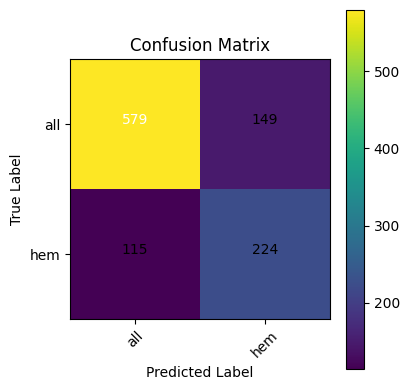

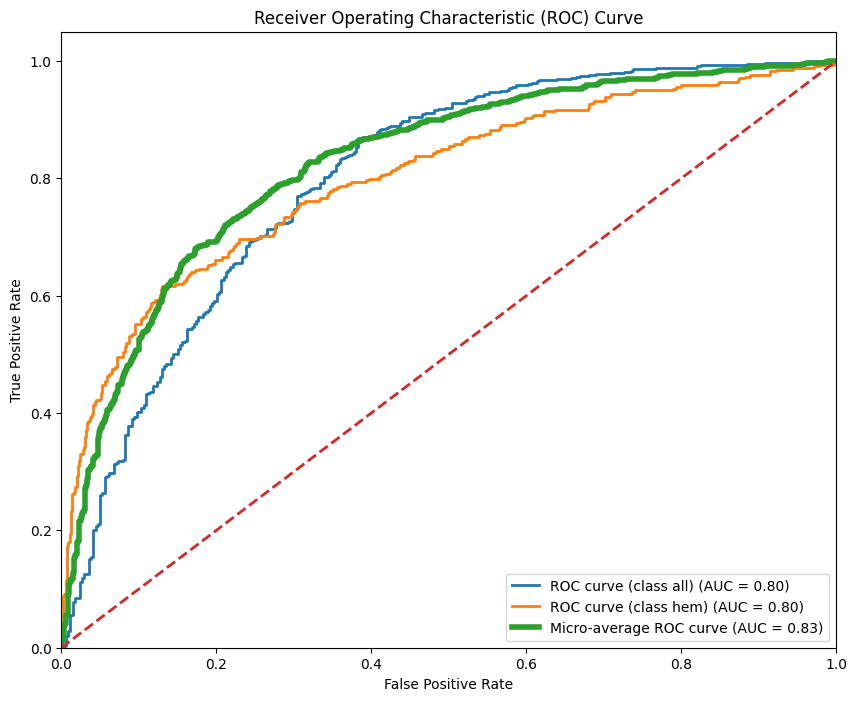

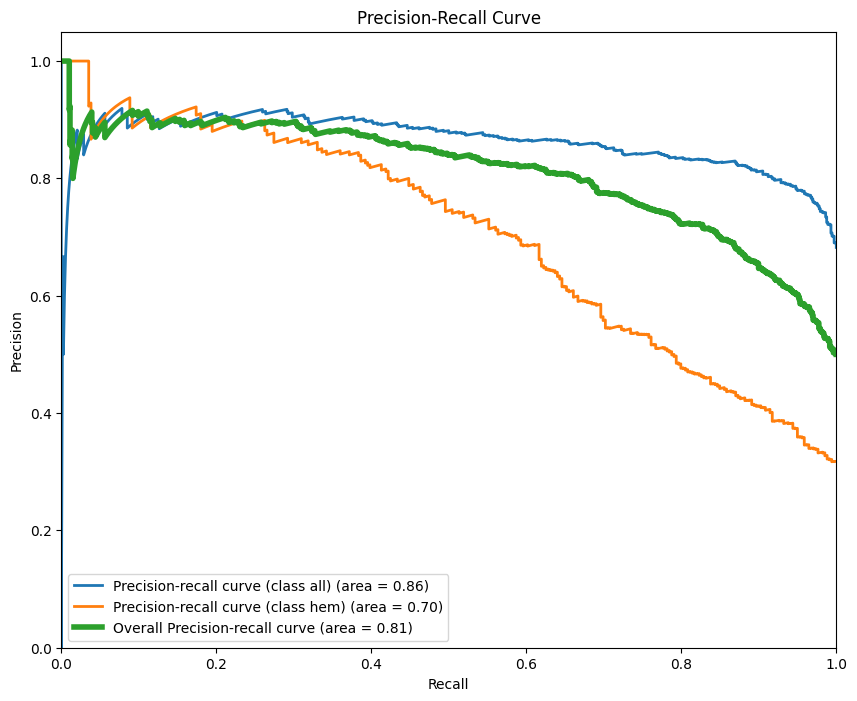

In [6]:
print('Evaluating global model on global test data.\n')
confusion_matrix = test_scores(global_test_gen, model)

Encryption/Decryption

In [7]:
import numpy as np
import matplotlib.pyplot as plt
from ipywidgets import interact, widgets

# Function to update and plot images
def update_and_plot(seed):
    np.random.seed(seed)
    key = np.random.randint(0, 256, size=image_shape, dtype=np.uint8)
    encrypted_image = encrypt_image(original_image, key)
    decrypted_image = decrypt_image(encrypted_image, key)
    plot_images(original_image, encrypted_image, decrypted_image)

# Load the original image
original_image = next(global_test_gen)[0][0] / 255
image_shape = original_image.shape

# Create a slider for seed value
seed_slider = widgets.IntSlider(value=0, min=0, max=1000, step=1, description='Seed:')

# Display the slider and bind the update function
interact(update_and_plot, seed=seed_slider)


interactive(children=(IntSlider(value=0, description='Seed:', max=1000), Output()), _dom_classes=('widget-inte…

<function __main__.update_and_plot(seed)>

In [8]:

replace2linear = ReplaceToLinear()
lime_explainer = lime_image.LimeImageExplainer()
efficientnet_layer = model.get_layer(backbone_model_layer_name)
efficientnet_model = keras.models.Model(inputs=efficientnet_layer.input, outputs=efficientnet_layer.output)

shap.initjs()
method = "inpaint_telea"  # "inpaint_ns" or "inpaint_telea" or "blur(28,28)"
masker = shap.maskers.Image(method, image_shape)
shap_explainer = shap.Explainer(model, masker, output_names=class_labels)


true_pos_images, true_neg_images, false_pos_images, false_neg_images = [], [], [], []
if number_of_classes == 2:
    true_pos_images, true_neg_images, false_pos_images, false_neg_images = get_images_for_xai_binary(datasets, model, confusion_matrix)
    print("Total TP, TN, FP and FN images respectively: \n", len(true_pos_images), len(true_neg_images), len(false_pos_images), len(false_neg_images))

elif number_of_classes > 2:
    true_pos_images, true_neg_images, false_pos_images, false_neg_images = get_images_for_xai_multi(datasets, model, number_of_classes, confusion_matrix)
    print("Total TP, TN, FP and FN images respectively: \n", len(true_pos_images), len(true_neg_images), len(false_pos_images), len(false_neg_images))

import plotly.graph_objects as go
from plotly.subplots import make_subplots

def display_images_in_grid(images, title):
    # Determine the grid size for plotting (for simplicity, using square layout)
    grid_size = int(len(images)**0.5)
    fig = make_subplots(rows=grid_size, cols=grid_size, subplot_titles=[f"Image {i+1}" for i in range(len(images))])

    # Add each image to the subplot
    for i, image in enumerate(images):
        row = (i // grid_size) + 1
        col = (i % grid_size) + 1
        fig.add_trace(go.Image(z=image), row=row, col=col)

    # Update layout
    fig.update_layout(height=200 * grid_size, width=200 * grid_size, title_text=title)

    fig.show()

# Usage with your existing code
display_images_in_grid(true_pos_images, 'True Positive Images')
display_images_in_grid(false_pos_images, 'False Positive Images')
display_images_in_grid(true_neg_images, 'True Negative Images')
display_images_in_grid(false_neg_images, 'False Negative Images')


Total TP, TN, FP and FN images respectively: 
 4 4 4 4


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 1s 589ms/step


WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


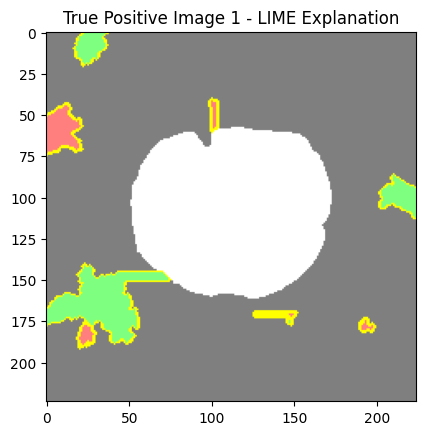

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 479ms/step


WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


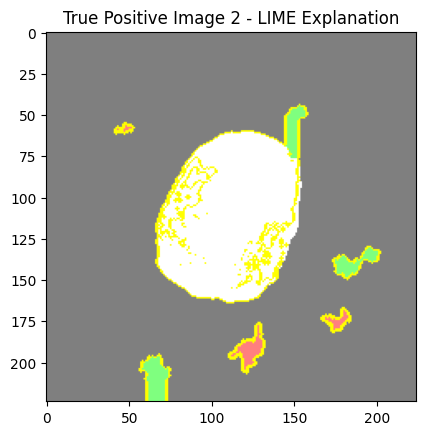

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 1s 615ms/step


WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


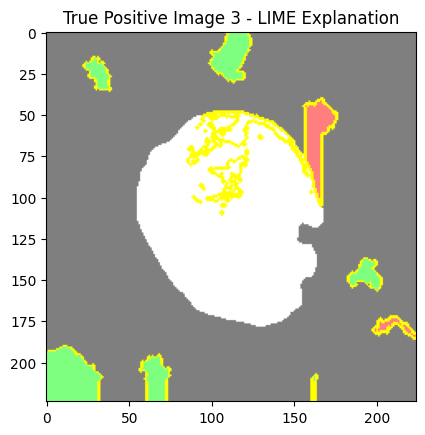

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 1s 508ms/step


WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


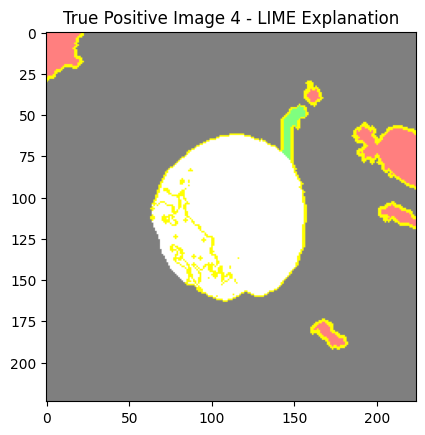

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 1s 593ms/step


WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


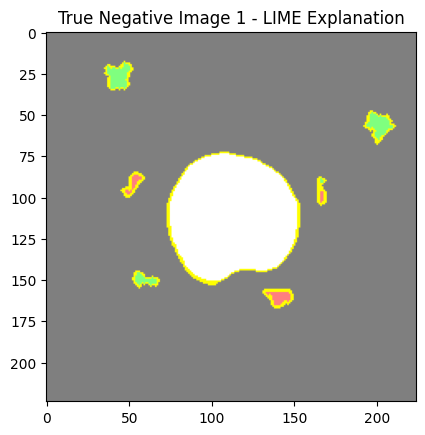

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 1s 536ms/step


WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


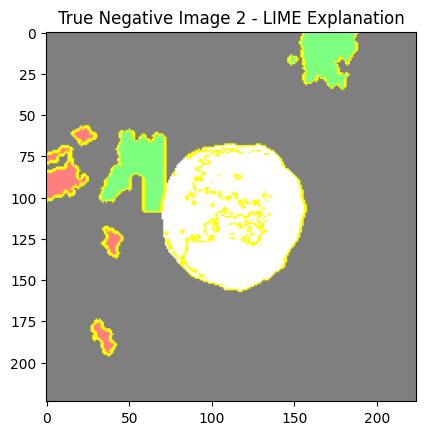

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 437ms/step


WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


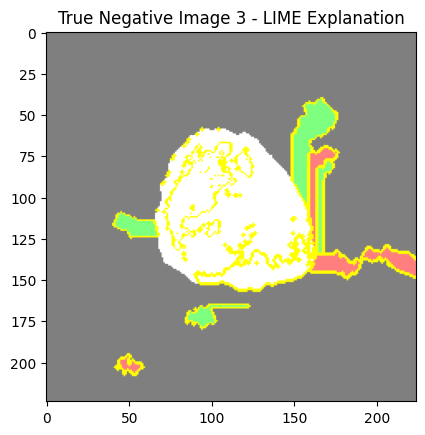

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 448ms/step


WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


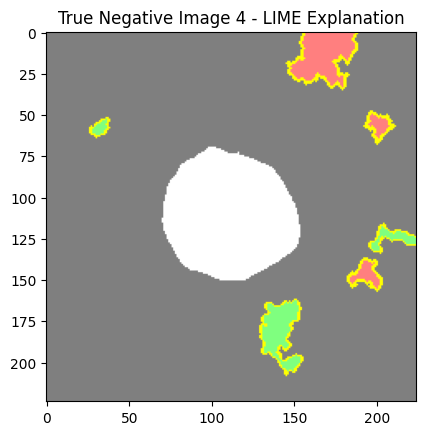

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 494ms/step


WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


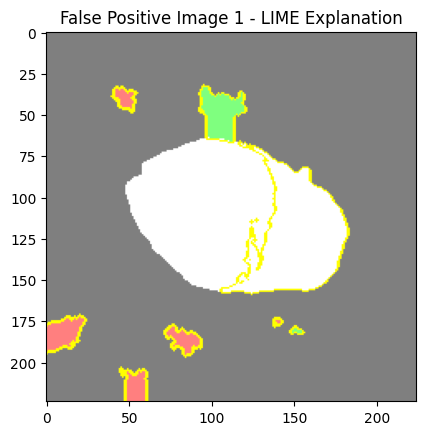

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 1s 594ms/step


WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


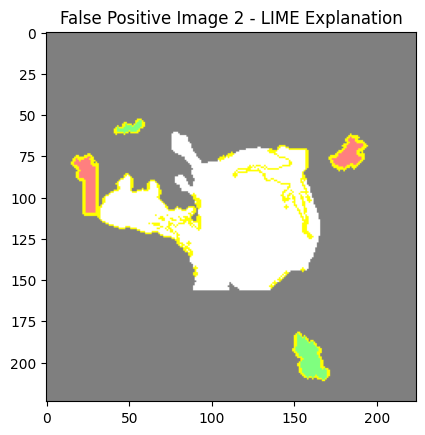

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 494ms/step


WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


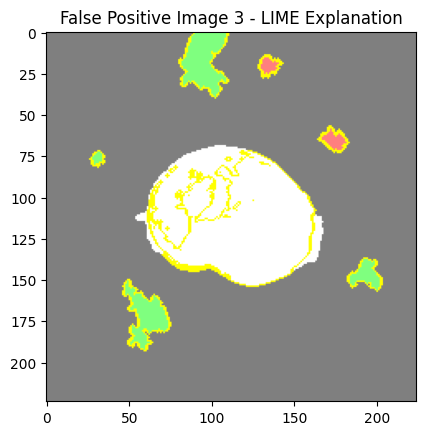

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 1s 559ms/step


WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


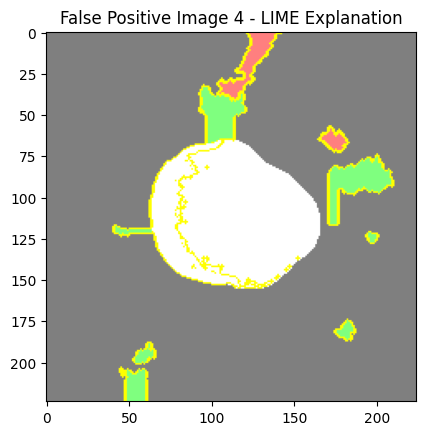

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 1s 568ms/step


WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


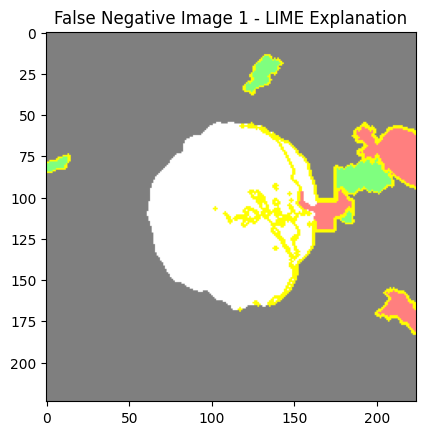

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 442ms/step


WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


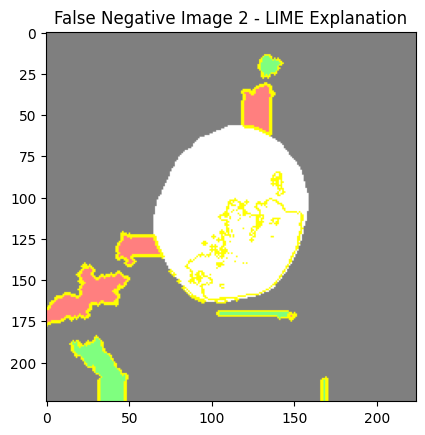

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 1s 507ms/step


WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


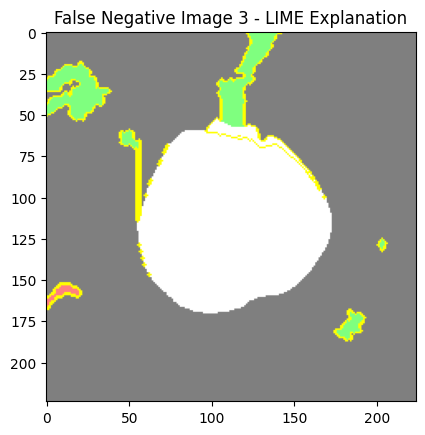

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 1s 516ms/step


WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


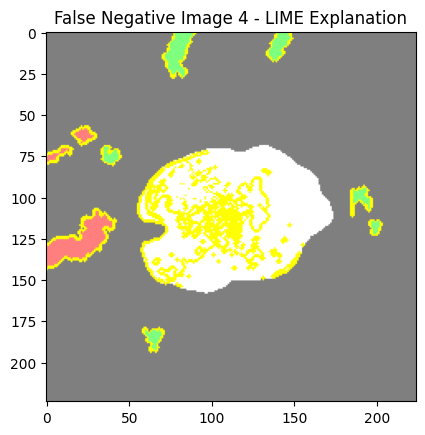

In [9]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries

def generate_explanations(image, model, shap_explainer, lime_explainer, title):

    # LIME Explanation
    explanation = lime_explainer.explain_instance(image, model.predict, top_labels=1, hide_color=0, num_samples=100)

    temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)
    plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))
    plt.title(f"{title} - LIME Explanation")
    plt.show()

# Function to display images in a grid
def display_images_in_grid(images, title):
    grid_size = int(len(images)**0.5)
    fig = make_subplots(rows=grid_size, cols=grid_size, subplot_titles=[f"Image {i+1}" for i in range(len(images))])

    for i, image in enumerate(images):
        row = (i // grid_size) + 1
        col = (i % grid_size) + 1
        fig.add_trace(go.Image(z=image), row=row, col=col)

    fig.update_layout(height=300 * grid_size, width=300 * grid_size, title_text=title)
    fig.show()

# Applying the function to each image category
for category, images in [("True Positive", true_pos_images), ("True Negative", true_neg_images),
                         ("False Positive", false_pos_images), ("False Negative", false_neg_images)]:
    display_images_in_grid(images, f'{category} Images')
    for i, image in enumerate(images):
        generate_explanations(image, model, shap_explainer, lime_explainer, f"{category} Image {i+1}")
        if i >= 5:  # Limit to first 5 images per category
            break


True Positive Images


True Positive:   0%|                                                                                                                                                                         | 0/4 [00:00<?, ?it/s]

1/1 [==============================] - 2s 2s/step


  0%|          | 0/1000 [00:00<?, ?it/s]

WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0]


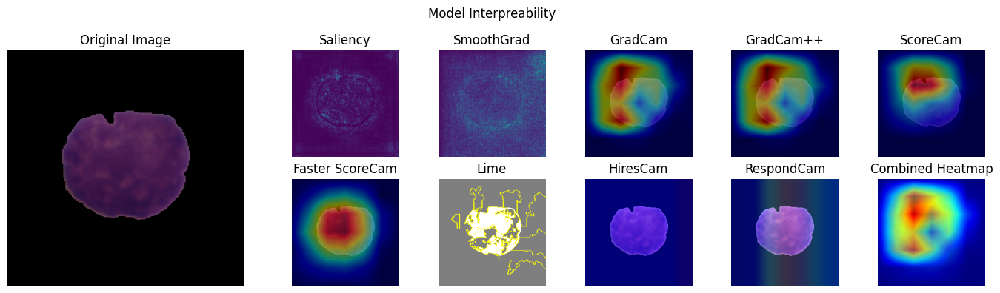

  0%|          | 0/498 [00:00<?, ?it/s]


PartitionExplainer explainer: 2it [01:10, 70.83s/it]                                                                                                                                                               
WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


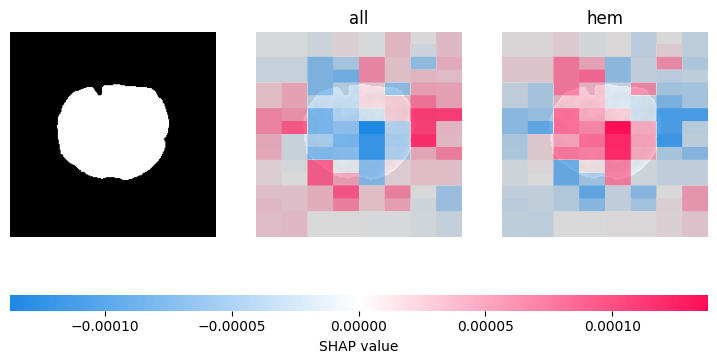

1/1 [==============================] - 0s 72ms/step


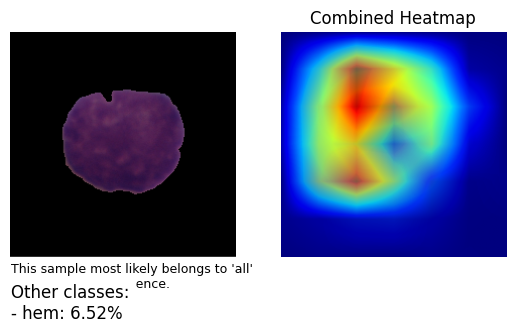

True Positive:  25%|████████████████████████████████████████                                                                                                                        | 1/4 [04:06<12:19, 246.46s/it]

1/1 [==============================] - 2s 2s/step


  0%|          | 0/1000 [00:00<?, ?it/s]

WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0]


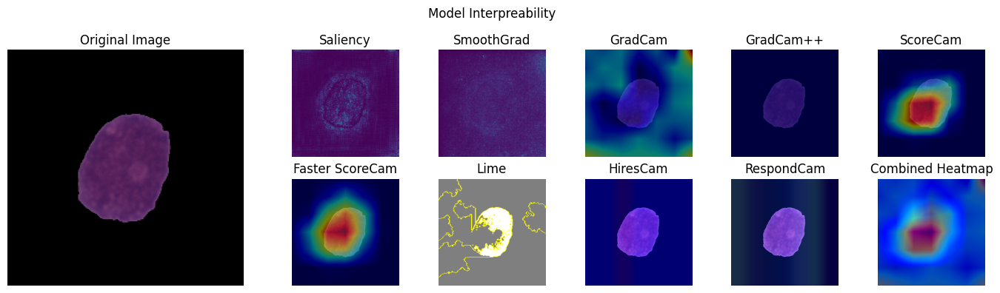

  0%|          | 0/498 [00:00<?, ?it/s]


PartitionExplainer explainer: 2it [00:56, 56.83s/it]                                                                                                                                                               
WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


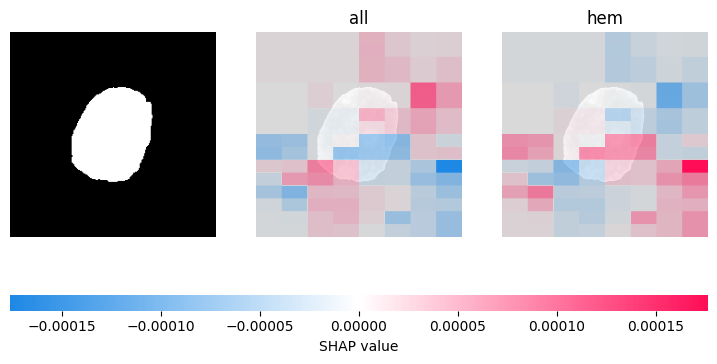

1/1 [==============================] - 0s 58ms/step


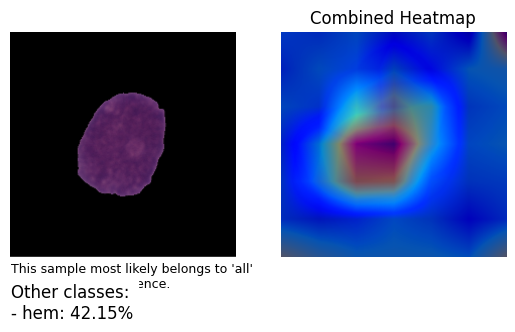

True Positive:  50%|████████████████████████████████████████████████████████████████████████████████                                                                                | 2/4 [07:52<07:49, 234.72s/it]

1/1 [==============================] - 2s 2s/step


  0%|          | 0/1000 [00:00<?, ?it/s]

WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0]


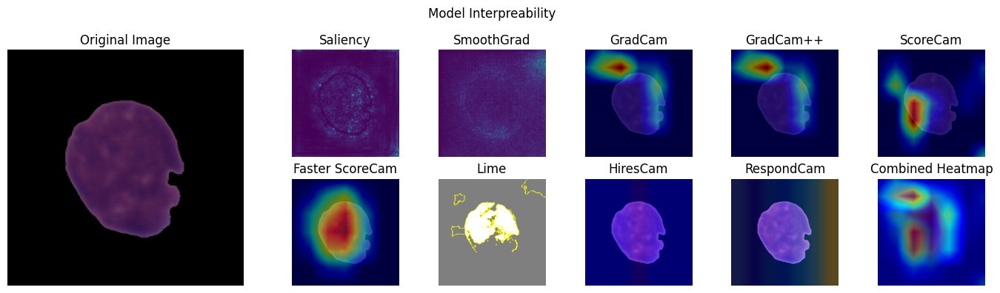

  0%|          | 0/498 [00:00<?, ?it/s]


PartitionExplainer explainer: 2it [00:59, 59.40s/it]                                                                                                                                                               
WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


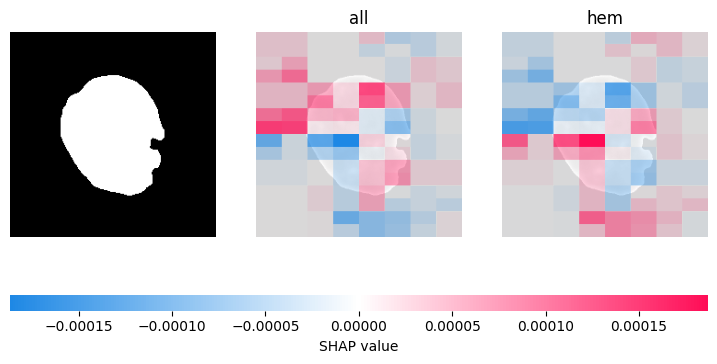

1/1 [==============================] - 0s 62ms/step


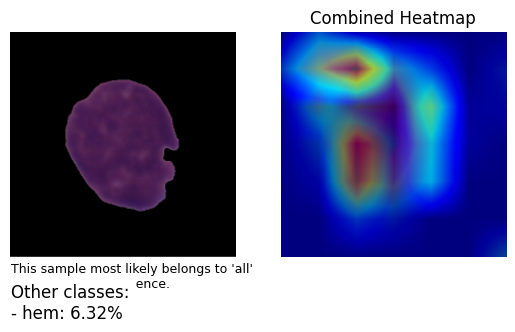

True Positive:  75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 3/4 [11:49<03:55, 235.42s/it]

1/1 [==============================] - 2s 2s/step


  0%|          | 0/1000 [00:00<?, ?it/s]

WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0]


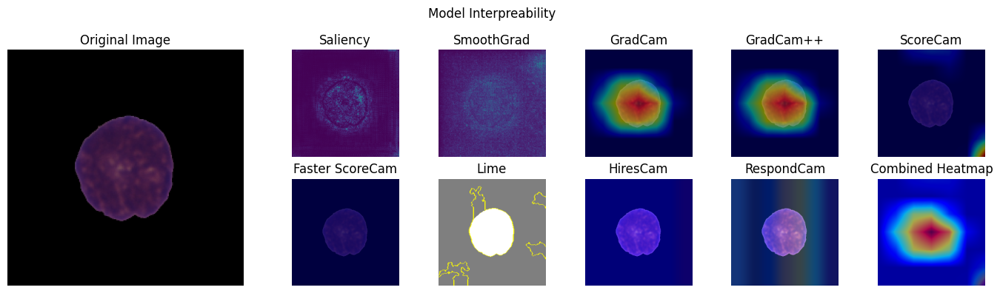

  0%|          | 0/498 [00:00<?, ?it/s]


PartitionExplainer explainer: 2it [00:58, 58.17s/it]                                                                                                                                                               
WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


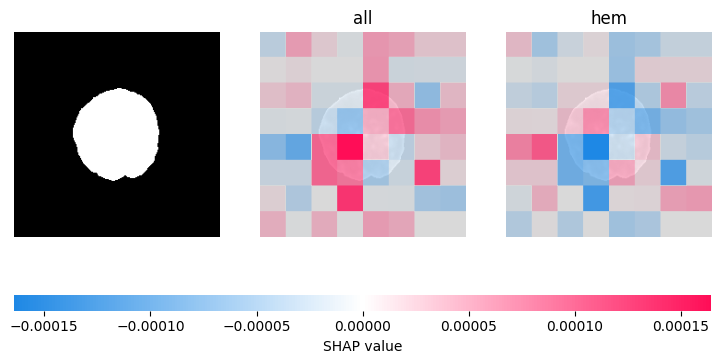

1/1 [==============================] - 0s 63ms/step


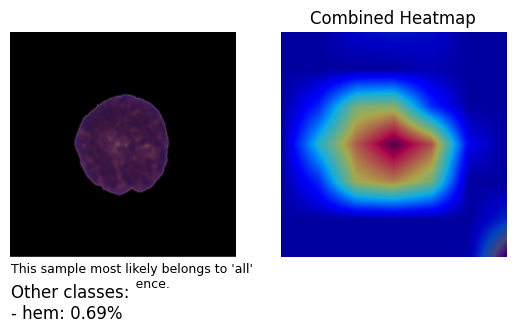

True Positive: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [15:30<00:00, 232.60s/it]


True Negative Images


True Negative:   0%|                                                                                                                                                                         | 0/4 [00:00<?, ?it/s]

1/1 [==============================] - 2s 2s/step


  0%|          | 0/1000 [00:00<?, ?it/s]

WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1]


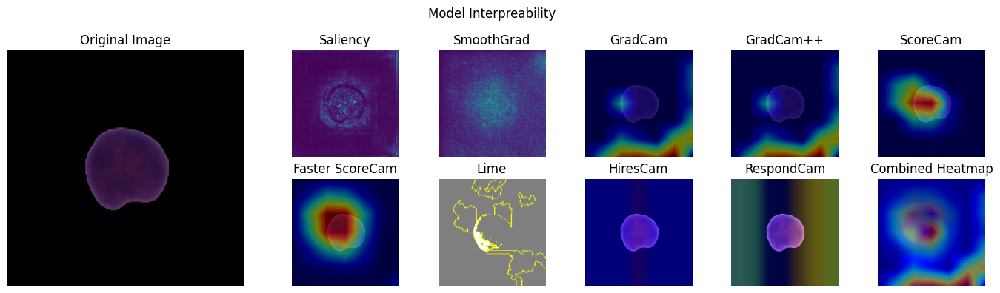

  0%|          | 0/498 [00:00<?, ?it/s]


PartitionExplainer explainer: 2it [00:55, 55.97s/it]                                                                                                                                                               
WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


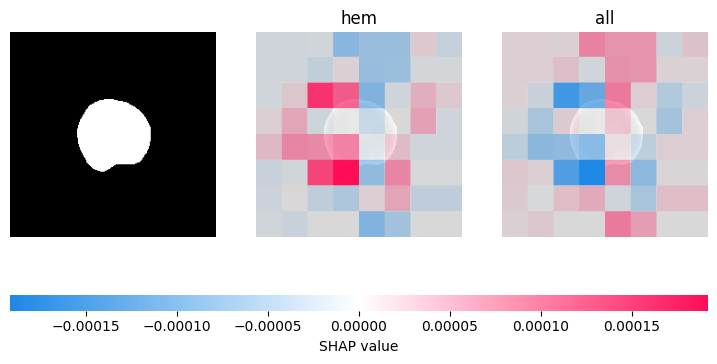

1/1 [==============================] - 0s 51ms/step


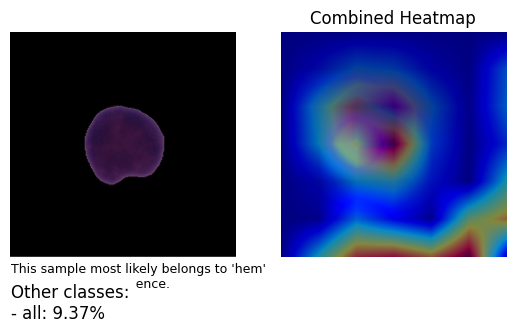

True Negative:  25%|████████████████████████████████████████                                                                                                                        | 1/4 [03:38<10:55, 218.37s/it]

1/1 [==============================] - 2s 2s/step


  0%|          | 0/1000 [00:00<?, ?it/s]

WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1]


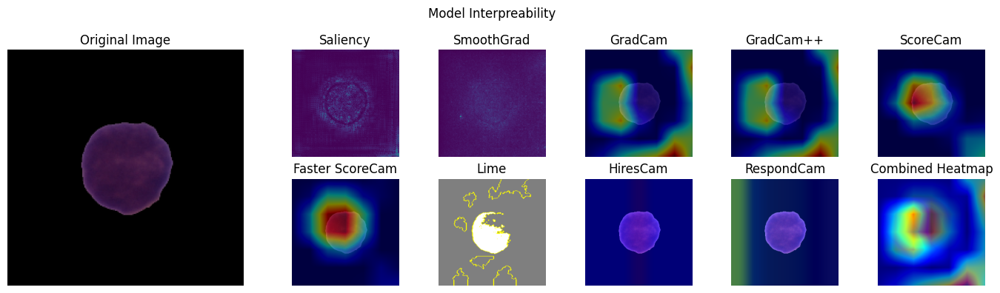

  0%|          | 0/498 [00:00<?, ?it/s]


PartitionExplainer explainer: 2it [00:53, 53.76s/it]                                                                                                                                                               
WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


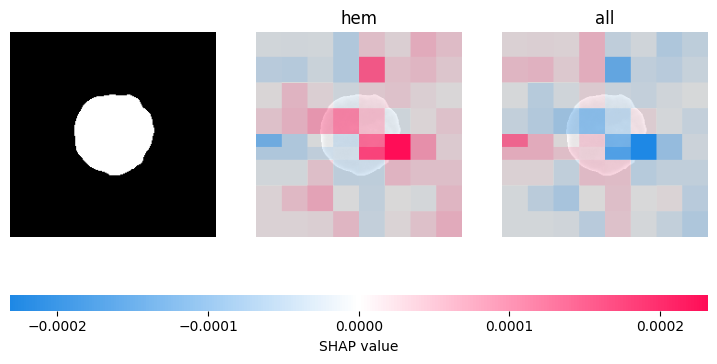

1/1 [==============================] - 0s 52ms/step


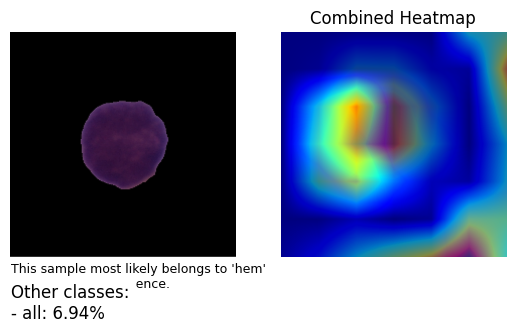

True Negative:  50%|████████████████████████████████████████████████████████████████████████████████                                                                                | 2/4 [07:13<07:12, 216.24s/it]

1/1 [==============================] - 2s 2s/step


  0%|          | 0/1000 [00:00<?, ?it/s]

WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1]


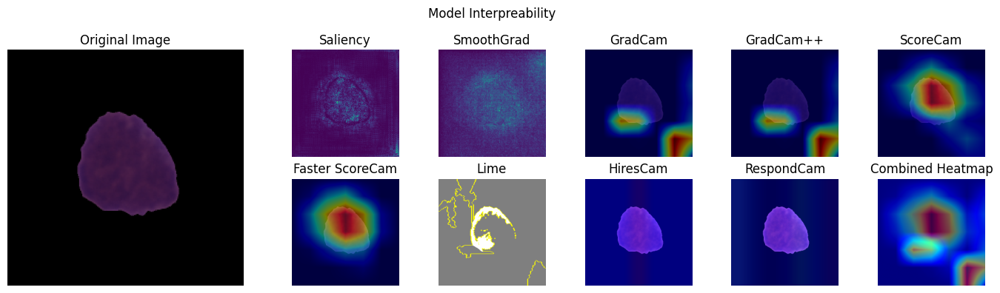

  0%|          | 0/498 [00:00<?, ?it/s]


PartitionExplainer explainer: 2it [00:55, 55.28s/it]                                                                                                                                                               
WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


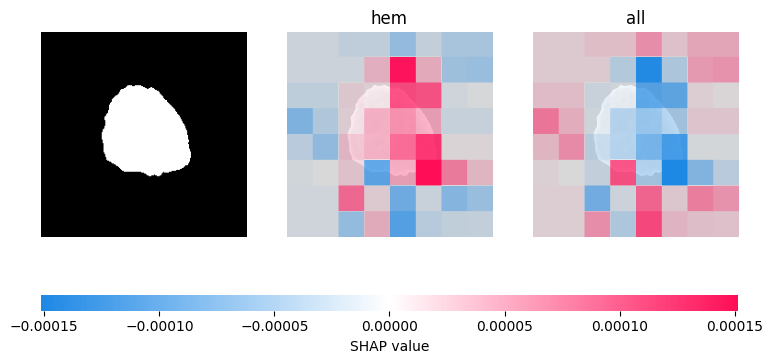

1/1 [==============================] - 0s 51ms/step


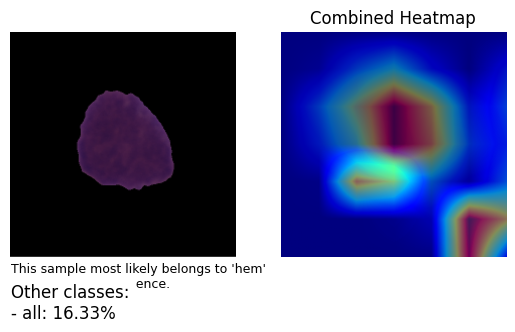

True Negative:  75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 3/4 [10:48<03:35, 215.85s/it]

1/1 [==============================] - 2s 2s/step


  0%|          | 0/1000 [00:00<?, ?it/s]

WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1]


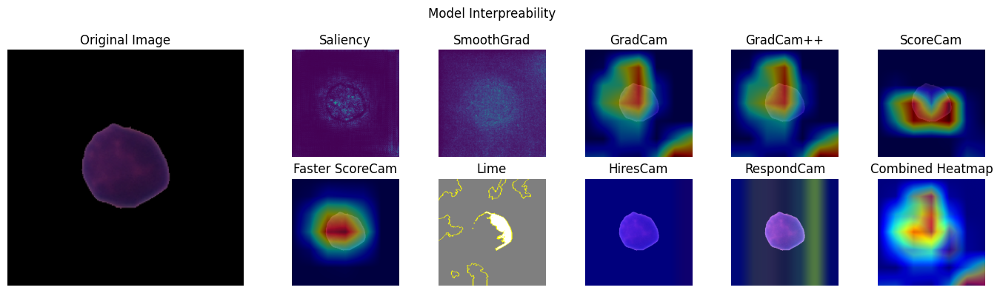

  0%|          | 0/498 [00:00<?, ?it/s]


PartitionExplainer explainer: 2it [01:06, 66.75s/it]                                                                                                                                                               
WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


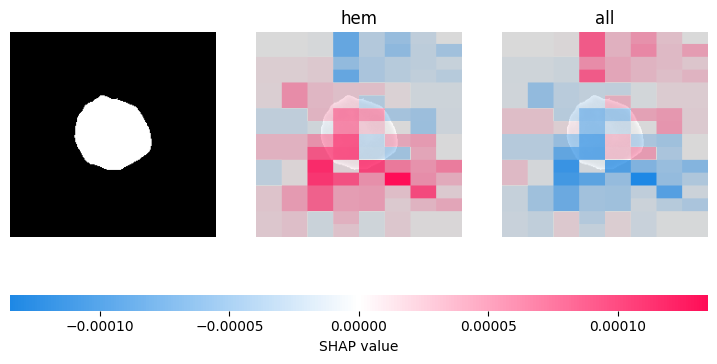

1/1 [==============================] - 0s 69ms/step


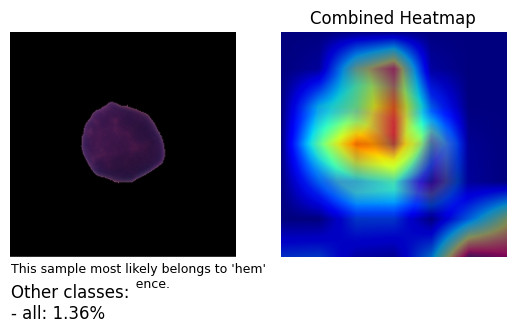

True Negative: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [14:43<00:00, 220.86s/it]


False Positive Images


False Positive:   0%|                                                                                                                                                                        | 0/4 [00:00<?, ?it/s]

1/1 [==============================] - 2s 2s/step


  0%|          | 0/1000 [00:00<?, ?it/s]

WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0]


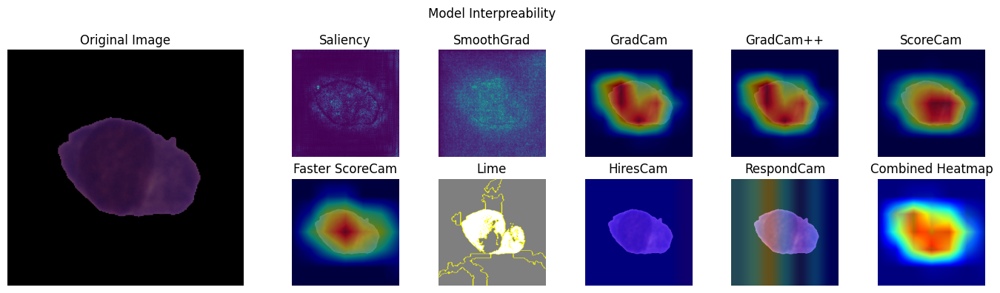

  0%|          | 0/498 [00:00<?, ?it/s]


PartitionExplainer explainer: 2it [00:56, 56.78s/it]                                                                                                                                                               
WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


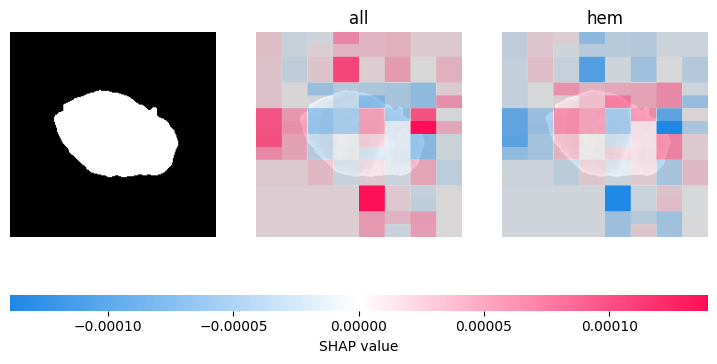

1/1 [==============================] - 0s 69ms/step


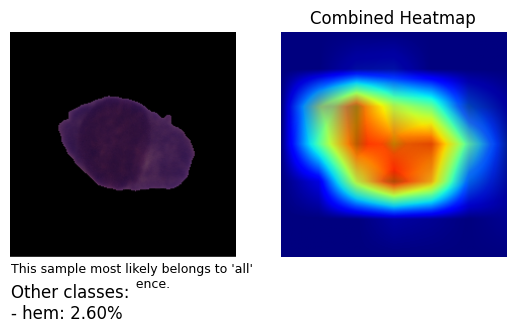

False Positive:  25%|███████████████████████████████████████▊                                                                                                                       | 1/4 [04:00<12:01, 240.42s/it]

1/1 [==============================] - 2s 2s/step


  0%|          | 0/1000 [00:00<?, ?it/s]

WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0]


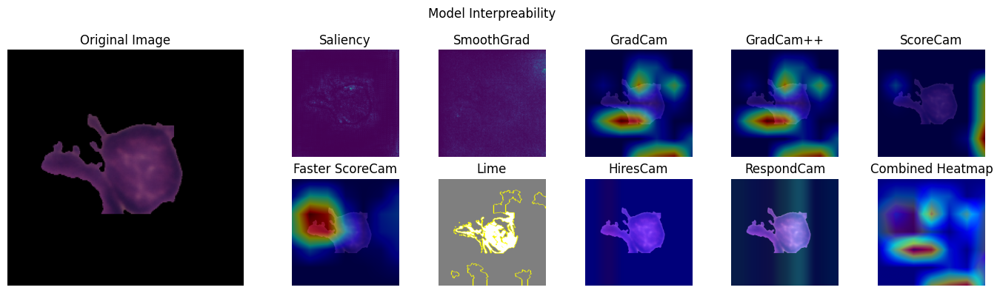

  0%|          | 0/498 [00:00<?, ?it/s]


PartitionExplainer explainer: 2it [01:05, 65.32s/it]                                                                                                                                                               
WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


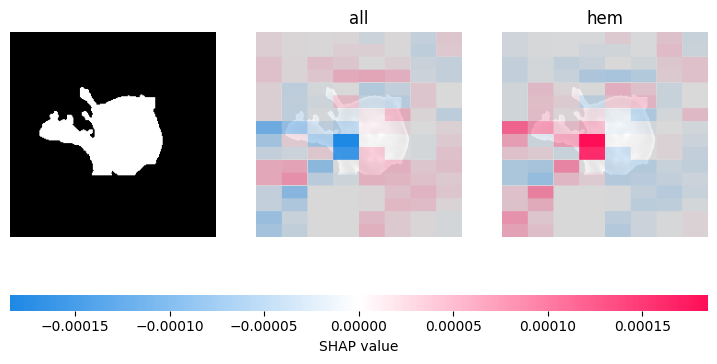

1/1 [==============================] - 0s 59ms/step


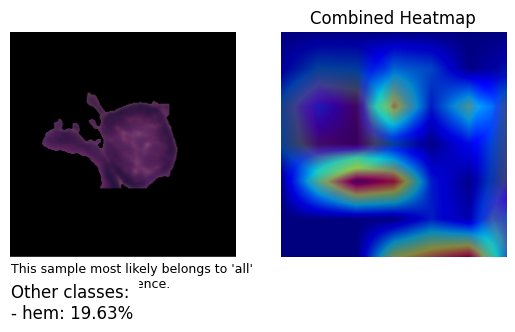

False Positive:  50%|███████████████████████████████████████████████████████████████████████████████▌                                                                               | 2/4 [08:08<08:09, 245.00s/it]

1/1 [==============================] - 2s 2s/step


  0%|          | 0/1000 [00:00<?, ?it/s]

WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0]


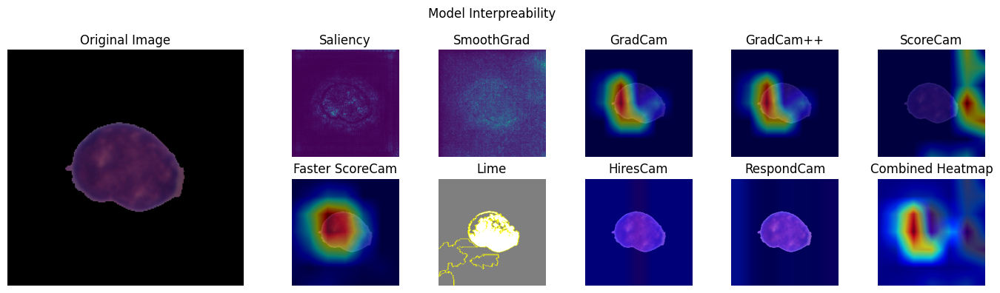

  0%|          | 0/498 [00:00<?, ?it/s]


PartitionExplainer explainer: 2it [00:58, 58.76s/it]                                                                                                                                                               
WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


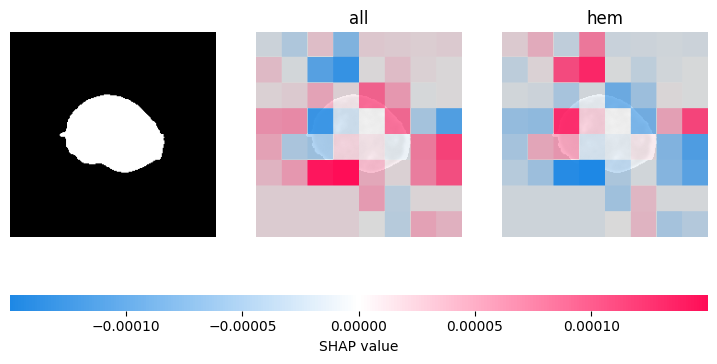

1/1 [==============================] - 0s 50ms/step


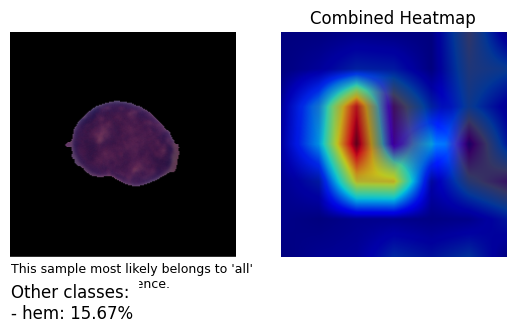

False Positive:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 3/4 [12:07<04:02, 242.12s/it]

1/1 [==============================] - 3s 3s/step


  0%|          | 0/1000 [00:00<?, ?it/s]

WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0]


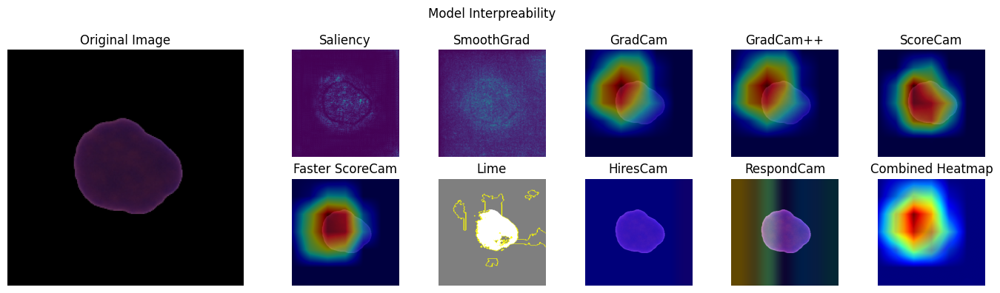

  0%|          | 0/498 [00:00<?, ?it/s]


PartitionExplainer explainer: 2it [01:05, 65.35s/it]                                                                                                                                                               
WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


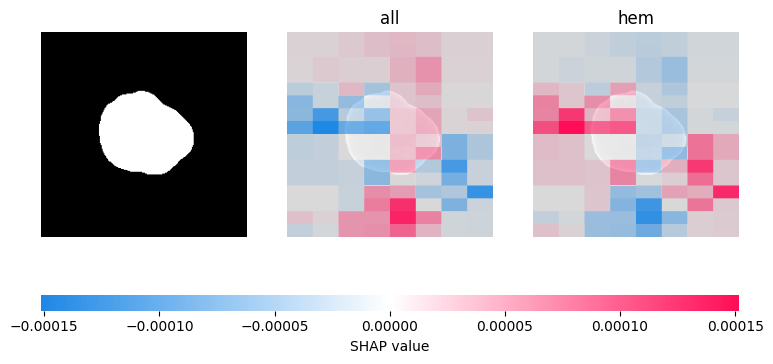

1/1 [==============================] - 0s 76ms/step


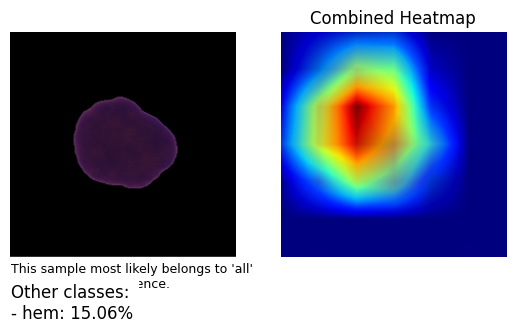

False Positive: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [16:33<00:00, 248.36s/it]


False Negative Images


False Negative:   0%|                                                                                                                                                                        | 0/4 [00:00<?, ?it/s]

1/1 [==============================] - 3s 3s/step


  0%|          | 0/1000 [00:00<?, ?it/s]

WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1]


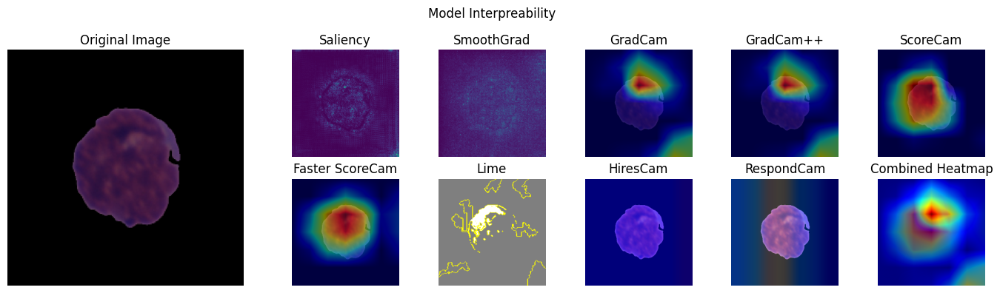

  0%|          | 0/498 [00:00<?, ?it/s]


PartitionExplainer explainer: 2it [00:55, 55.73s/it]                                                                                                                                                               
WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


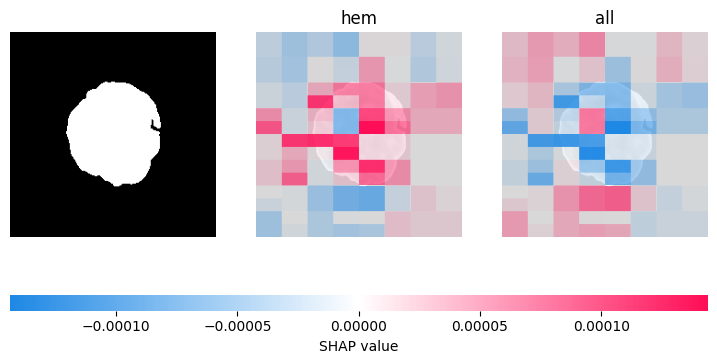

1/1 [==============================] - 0s 54ms/step


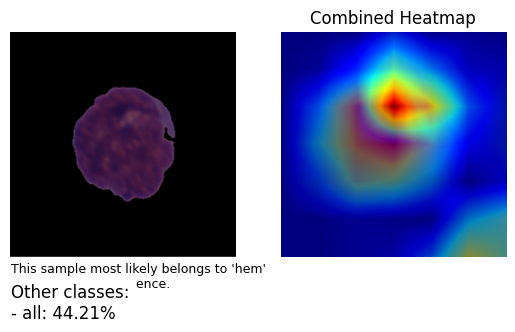

False Negative:  25%|███████████████████████████████████████▊                                                                                                                       | 1/4 [04:17<12:52, 257.45s/it]

1/1 [==============================] - 2s 2s/step


  0%|          | 0/1000 [00:00<?, ?it/s]

WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1]


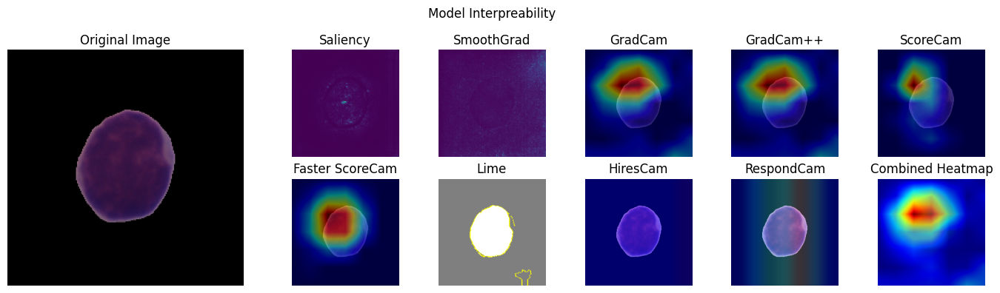

  0%|          | 0/498 [00:00<?, ?it/s]


PartitionExplainer explainer: 2it [00:55, 55.08s/it]                                                                                                                                                               
WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


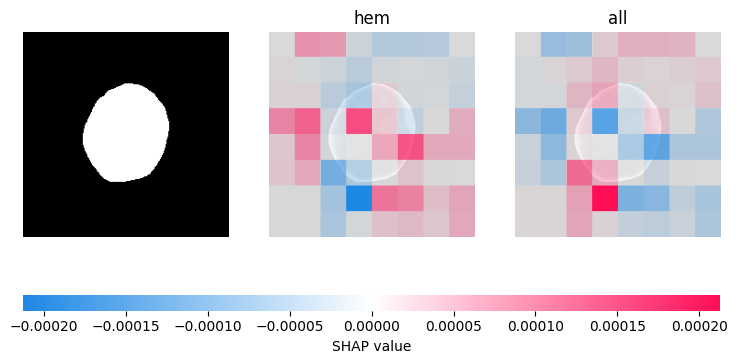

1/1 [==============================] - 0s 60ms/step


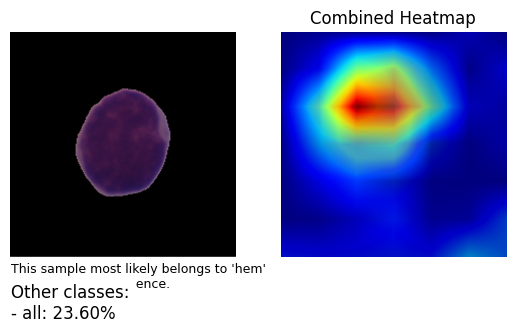

False Negative:  50%|███████████████████████████████████████████████████████████████████████████████▌                                                                               | 2/4 [08:16<08:13, 246.89s/it]

1/1 [==============================] - 2s 2s/step


  0%|          | 0/1000 [00:00<?, ?it/s]

WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1]


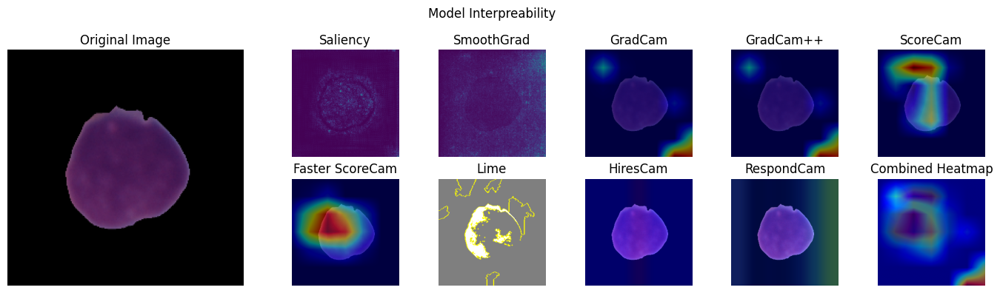

  0%|          | 0/498 [00:00<?, ?it/s]


PartitionExplainer explainer: 2it [00:55, 55.76s/it]                                                                                                                                                               
WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


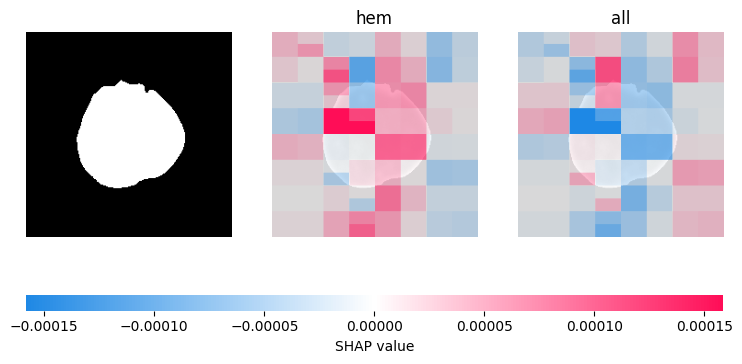

1/1 [==============================] - 0s 48ms/step


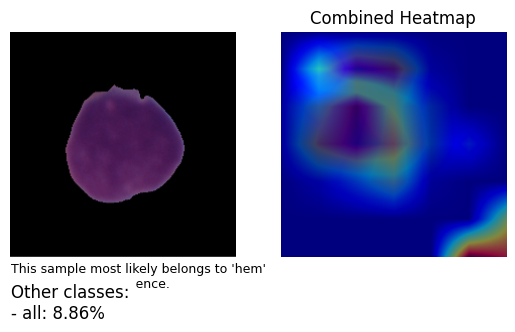

False Negative:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 3/4 [11:58<03:55, 235.47s/it]

1/1 [==============================] - 2s 2s/step


  0%|          | 0/1000 [00:00<?, ?it/s]

WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[1]


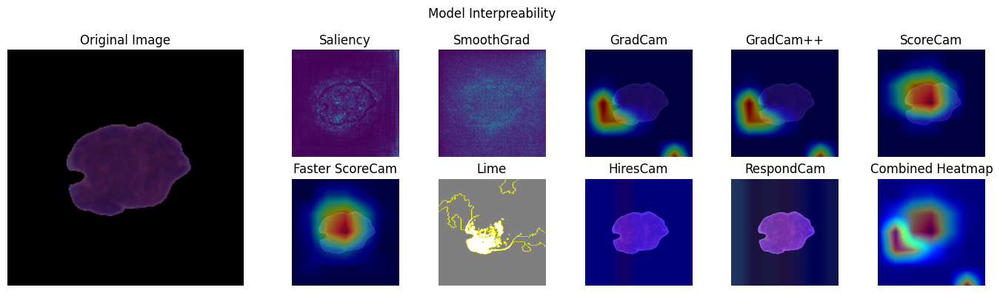

  0%|          | 0/498 [00:00<?, ?it/s]


PartitionExplainer explainer: 2it [00:55, 55.51s/it]                                                                                                                                                               
WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


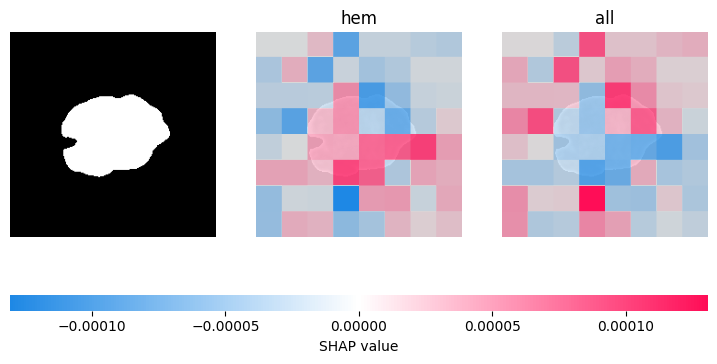

1/1 [==============================] - 0s 66ms/step


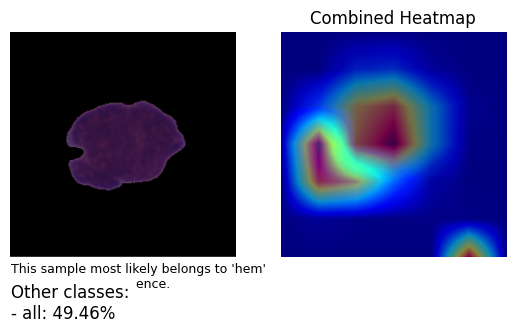

False Negative: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [15:32<00:00, 233.21s/it]


In [10]:

from tqdm import tqdm
def process_and_display_images(image_category, images):
    print(f'{image_category} Images')
    for i in tqdm(range(len(images)), desc=image_category):
        combined_heatmap = plot_xia_interpretability(images[i:i+1], model, efficientnet_model, replace2linear, shap_explainer, lime_explainer, class_labels, layer_name, layer_id)
        predict_and_display(images[i], model, class_labels, True, combined_heatmap)

# Process and display images for each category
process_and_display_images('True Positive', true_pos_images)
process_and_display_images('True Negative', true_neg_images)
process_and_display_images('False Positive', false_pos_images)
process_and_display_images('False Negative', false_neg_images)

In [11]:
for img_types in ['true_pos_images', 'false_pos_images', 'true_neg_images', 'false_neg_images']:

  print(img_types)

  if img_types == 'true_pos_images':
    test_labels = np.array([0])
  elif img_types == 'false_pos_images':
    test_labels = np.array([0])
  elif img_types == 'true_neg_images':
    test_labels = np.array([1])
  elif img_types == 'false_neg_images':
    test_labels = np.array([1])

  test_images = true_neg_images

  for i in range(len(test_images)):
    test_image = test_images[i:i+1]

    infidelity = calculate_infidelity(model, model, test_image)
    display(f'Infidelity: {infidelity}')

    sensitivity = calculate_sensitivity(model, test_image[0])
    display(f'Sensitivity: {sensitivity}')

true_pos_images
1/1 [==============================] - 0s 58ms/step


'Infidelity: [0.]'

7/7 [==============================] - 9s 1s/step


'Sensitivity: 7.980598638823722e-06'

1/1 [==============================] - 0s 50ms/step


'Infidelity: [0.]'

7/7 [==============================] - 9s 1s/step


'Sensitivity: 1.8510603695176542e-05'

1/1 [==============================] - 0s 71ms/step


'Infidelity: [0.]'

7/7 [==============================] - 10s 1s/step


'Sensitivity: 3.113127240794711e-05'

1/1 [==============================] - 0s 61ms/step


'Infidelity: [0.]'

7/7 [==============================] - 10s 1s/step


'Sensitivity: 2.9541953949774324e-07'

false_pos_images
1/1 [==============================] - 0s 65ms/step


'Infidelity: [0.]'

7/7 [==============================] - 10s 1s/step


'Sensitivity: 8.71938573254738e-06'

1/1 [==============================] - 0s 60ms/step


'Infidelity: [0.]'

7/7 [==============================] - 10s 1s/step


'Sensitivity: 1.8738675862550735e-05'

1/1 [==============================] - 0s 58ms/step


'Infidelity: [0.]'

7/7 [==============================] - 10s 1s/step


'Sensitivity: 2.6309686290915124e-05'

1/1 [==============================] - 0s 56ms/step


'Infidelity: [0.]'

7/7 [==============================] - 10s 1s/step


'Sensitivity: 2.8990899636482936e-07'

true_neg_images
1/1 [==============================] - 0s 57ms/step


'Infidelity: [0.]'

7/7 [==============================] - 10s 1s/step


'Sensitivity: 8.509748113283422e-06'

1/1 [==============================] - 0s 61ms/step


'Infidelity: [0.]'

7/7 [==============================] - 10s 1s/step


'Sensitivity: 1.8380742403678596e-05'

1/1 [==============================] - 0s 55ms/step


'Infidelity: [0.]'

7/7 [==============================] - 9s 1s/step


'Sensitivity: 2.5009907403727993e-05'

1/1 [==============================] - 0s 60ms/step


'Infidelity: [0.]'

7/7 [==============================] - 9s 1s/step


'Sensitivity: 2.3220864875383995e-07'

false_neg_images
1/1 [==============================] - 0s 61ms/step


'Infidelity: [0.]'

7/7 [==============================] - 9s 1s/step


'Sensitivity: 9.046620107255876e-06'

1/1 [==============================] - 0s 56ms/step


'Infidelity: [0.]'

7/7 [==============================] - 10s 1s/step


'Sensitivity: 1.670949495746754e-05'

1/1 [==============================] - 0s 55ms/step


'Infidelity: [0.]'

7/7 [==============================] - 10s 1s/step


'Sensitivity: 3.069624654017389e-05'

1/1 [==============================] - 0s 62ms/step


'Infidelity: [0.]'

7/7 [==============================] - 10s 1s/step


'Sensitivity: 2.680478417005361e-07'

In [12]:

%matplotlib inline
%config InlineBackend.figure_format='retina'

#The Deletion Fidelity metric measures how well a saliency-map–based explanation localizes the important features.
#The Insertion Fidelity metric measures how well a saliency-map–based explanation can find elements that are minimal for the predictions.
#MuFidelity is a fidelity metric measuring the correlation between important variables defined by the explanation method and the decline in the model score when these variables are reset to a baseline state.
#Average Stability is a Stability metric measuring how similar are explanations of similar inputs.
from xplique.metrics import AverageStability,MuFidelity,Insertion,Deletion
from xplique.plots import plot_attributions
from xplique.attributions import (Saliency, GradientInput, IntegratedGradients, SmoothGrad, VarGrad,
                                  SquareGrad, GradCAM, Occlusion, Rise, GuidedBackprop,
                                  GradCAMPP, Lime, KernelShap, SobolAttributionMethod)

1/1 [==============================] - 2s 2s/step
Predicted_label: hem
Prediction Confidence Percentage is:  99.9821126461029
Method Name:IntegratedGradients


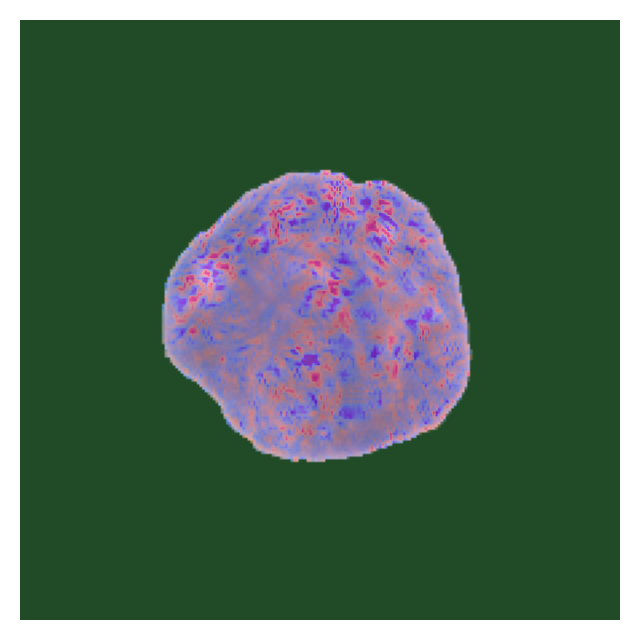

Method Name:Saliency


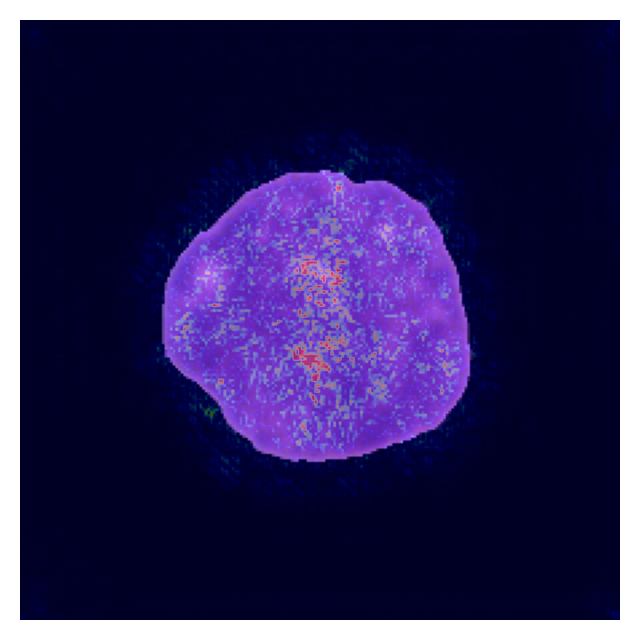

Method Name:Gradient


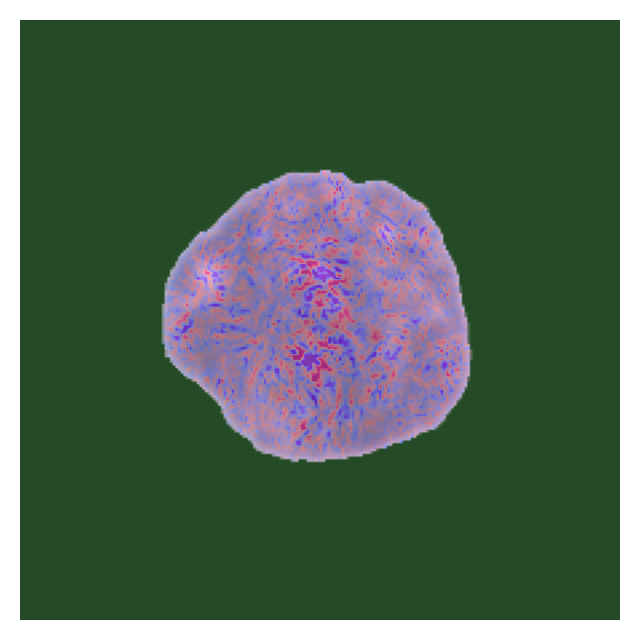

Method Name:GuidedBackprop


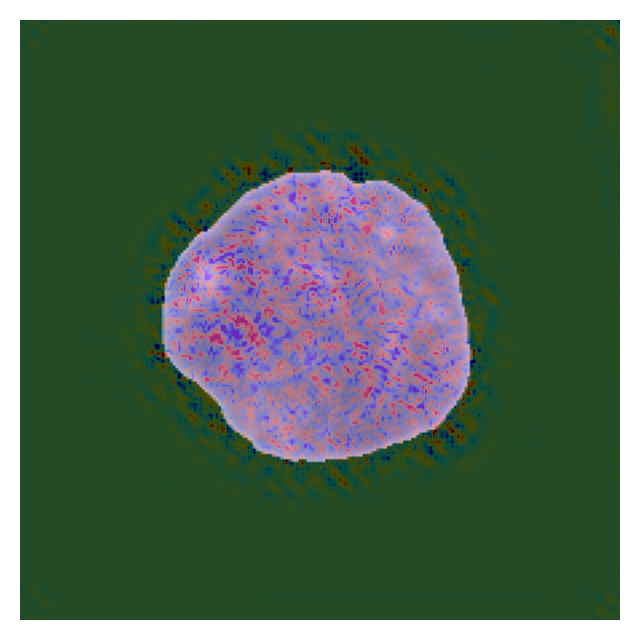

Method Name:SmoothGrad


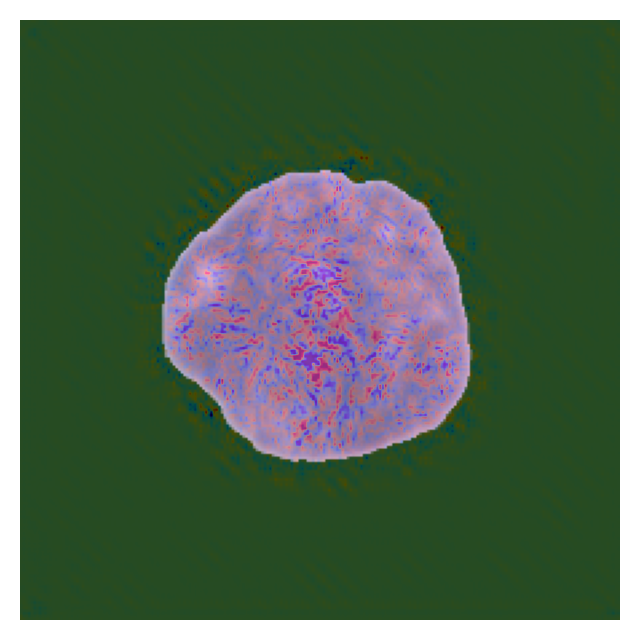

Method Name:SquareGrad


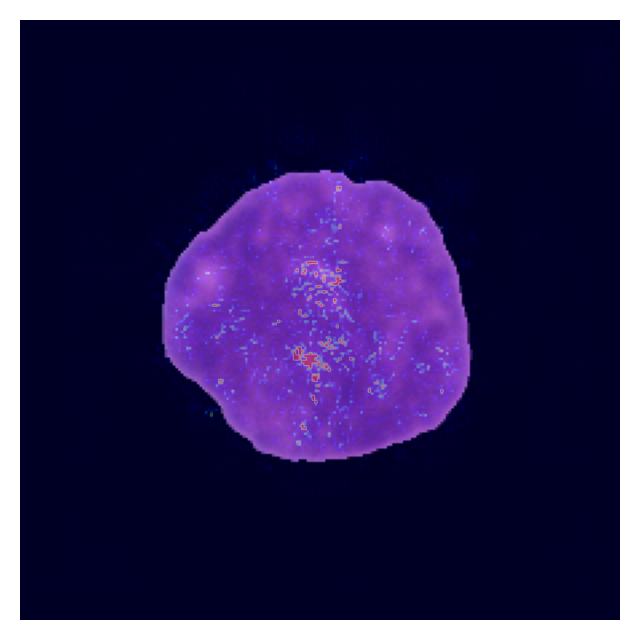

Method Name:VarGrad


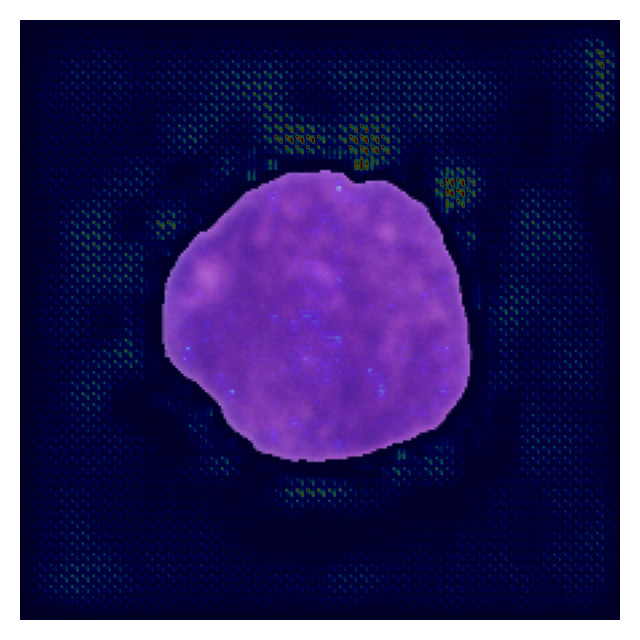

Method Name:Occlusion


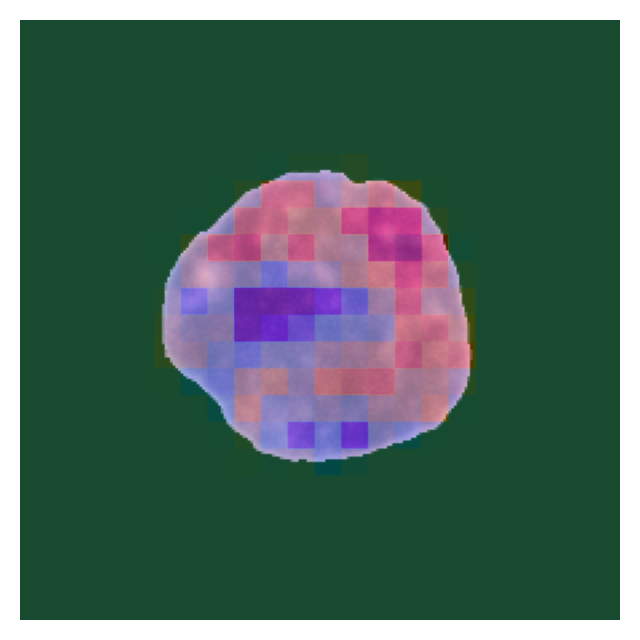

Method Name:SobotAttribution


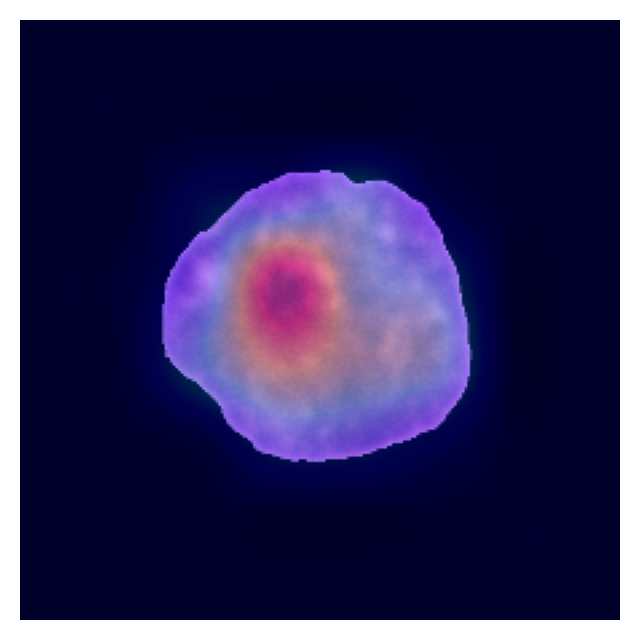

WARNING	matplotlib.image:image.py:set_data()- Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Segments


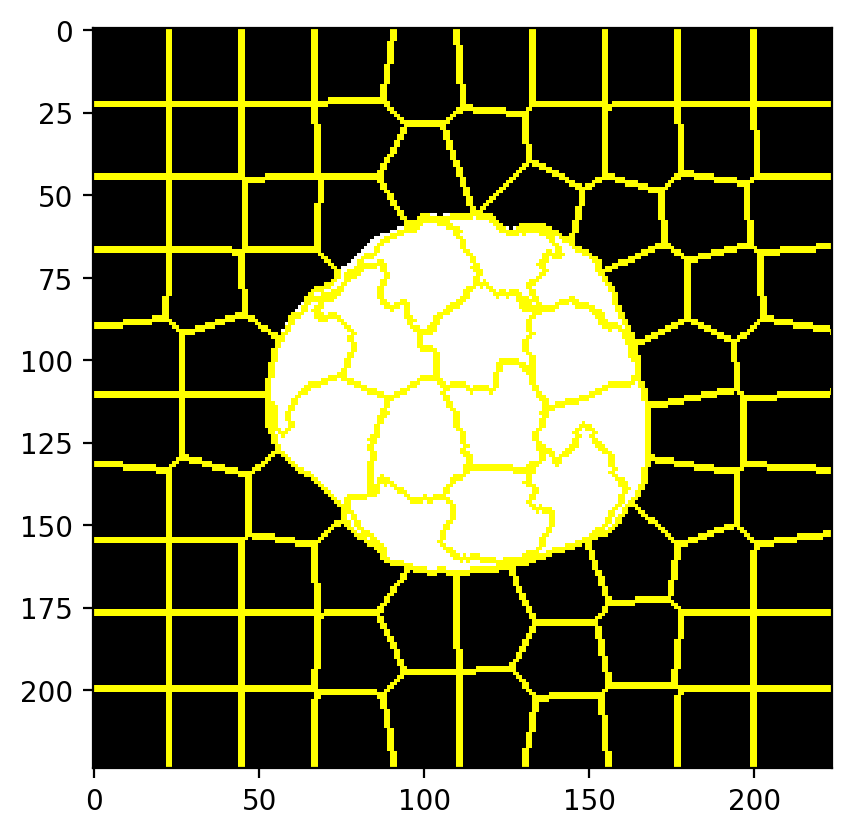

In [15]:
# Load your TensorFlow model
index = 10
model = get_model()
x_batch, y_batch = next(iter(global_test_gen))
input_image = x_batch[index]
# Add a batch dimension to the first image in the batch
x_single = np.expand_dims(input_image, axis=0)  # This changes the shape from (224, 224, 3) to (1, 224, 224, 3)
y_predicted = model.predict(x_single)
pct = np.max(y_predicted)
predicted_indices = np.argmax(y_predicted, axis=1)
# Map indices to class labels
predicted_labels = [class_labels[idx] for idx in predicted_indices]

print('Predicted_label: '+predicted_labels[0])
print("Prediction Confidence Percentage is: ", pct*100)

model.layers[-1].activation = tf.keras.activations.linear
explainers = {
    "IntegratedGradients": IntegratedGradients(model,
                                output_layer=-1, batch_size=16,
                                steps=50, baseline_value=0),
     "Saliency":     Saliency(model),
     "Gradient":GradientInput(model),
     "GuidedBackprop":GuidedBackprop(model),
     "SmoothGrad":SmoothGrad(model, nb_samples=50, batch_size=batch_size),
     "SquareGrad":SquareGrad(model, nb_samples=50, batch_size=batch_size),
     "VarGrad":VarGrad(model, nb_samples=50, batch_size=batch_size),
     "Occlusion":Occlusion(model, patch_size=10, patch_stride=10, batch_size=batch_size),
     "SobotAttribution":SobolAttributionMethod(model, batch_size=batch_size),
}

# iterate on all methods
for method_name, explainer in explainers.items():
    # compute explanation by calling the explainer
    print(f"Method Name:{method_name}")
    explanation = explainer.explain(x_single, y_predicted)
    plot_attributions(explanation, x_single, img_size=3, cols=1, cmap='jet', alpha=0.3, absolute_value=False,)
    plt.show()

print("Segments")
from lime.wrappers.scikit_image import SegmentationAlgorithm
from skimage.segmentation import mark_boundaries

segmentation_fn = SegmentationAlgorithm(
    'slic',
    kernel_size=4,
    max_dist=200,
    ratio=0.2,
    random_seed=42
)

segments = segmentation_fn(input_image)
plt.imshow(mark_boundaries(np.array(input_image), segments));